<a href="https://colab.research.google.com/github/tbrown9999/git_practice/blob/master/VISR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Preparation

Attaching Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# All of the files in your Google Drive are accessible as '/content/drive/...'

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


Setting Up Environment

In [ ]:
import folium
from folium import plugins
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Toy Example

Downloading Data

In [ ]:
!wget "https://s3.amazonaws.com/divvy-data/tripdata/Divvy_Trips_2016_Q3Q4.zip"

--2020-03-26 13:05:14--  https://s3.amazonaws.com/divvy-data/tripdata/Divvy_Trips_2016_Q3Q4.zip
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.28.198
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.28.198|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 57215032 (55M) [application/zip]
Saving to: ‘Divvy_Trips_2016_Q3Q4.zip’

Divvy_Trips_2016_Q3 100%[===================>]  54.56M  89.6MB/s    in 0.6s    

2020-03-26 13:05:15 (89.6 MB/s) - ‘Divvy_Trips_2016_Q3Q4.zip’ saved [57215032/57215032]



Preparing Data

In [ ]:
!mkdir data
!mv Divvy_Trips_2016_Q3Q4.zip data/Divvy_Trips_2016_Q3Q4.zip
!unzip data/Divvy_Trips_2016_Q3Q4.zip -d data/Divvy_Trips_2016_Q3Q4

Archive:  data/Divvy_Trips_2016_Q3Q4.zip
  inflating: data/Divvy_Trips_2016_Q3Q4/Divvy_Stations_2016_Q4.csv  
  inflating: data/Divvy_Trips_2016_Q3Q4/Divvy_Trips_2016_Q3.csv  
  inflating: data/Divvy_Trips_2016_Q3Q4/README_2016_Q4.txt  
  inflating: data/Divvy_Trips_2016_Q3Q4/README_2016_Q3.txt  
  inflating: data/Divvy_Trips_2016_Q3Q4/Divvy_Stations_2016_Q3.csv  
  inflating: data/Divvy_Trips_2016_Q3Q4/Divvy_Trips_2016_Q4.csv  


Loading Data into Pandas

In [ ]:
divvyStations_q3 = pd.read_csv('data/Divvy_Trips_2016_Q3Q4/Divvy_Stations_2016_Q3.csv')
divvyStations_q4 = pd.read_csv('data/Divvy_Trips_2016_Q3Q4/Divvy_Stations_2016_Q4.csv')

# Combine two datasets and remove any duplicates
divvyStations = pd.concat([divvyStations_q3, divvyStations_q4], axis=0).drop_duplicates(subset=['id'])

divvyStations.head()

,id,name,latitude,longitude,dpcapacity,online_date
0,456,2112 W Peterson Ave,41.991178,-87.683593,15,5/12/2015
1,101,63rd St Beach,41.781016,-87.576120,23,4/20/2015
2,109,900 W Harrison St,41.874675,-87.650019,19,8/6/2013
3,21,Aberdeen St & Jackson Blvd,41.877726,-87.654787,15,6/21/2013
4,80,Aberdeen St & Monroe St,41.880420,-87.655599,19,6/26/2013


Visualizing Data

In [ ]:
m = folium.Map([41.8781, -87.6298], zoom_start=11)
m

Plotting Points

In [ ]:
# Mark each station as a point
for index, row in divvyStations.iterrows():
    folium.CircleMarker([row['latitude'], row['longitude']], radius=2, weight=1, popup=row['name']).add_to(m)
m

Add Heatmap

In [ ]:
# convert to (n, 2) nd-array format for heatmap
stationArr = divvyStations[['latitude', 'longitude']].as_matrix()

# plot heatmap
m.add_children(plugins.HeatMap(stationArr, radius=15))
m

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: FutureWarning: Method `add_children` is deprecated. Please use `add_child` instead.
  after removing the cwd from sys.path.


# New Section

Setting Environment

In [ ]:
from shapely.geometry import Point, Polygon

# Create Point objects
p1 = Point(24.952242, 60.1696017)
p2 = Point(24.976567, 60.1612500)

# Create a Polygon
coords = [(24.950899, 60.169158), (24.953492, 60.169158), (24.953510, 60.170104), (24.950958, 60.169990)]
poly = Polygon(coords)

In [ ]:
# Check if p1 is within the polygon using the within function
p1.within(poly)

# Check if p2 is within the polygon
#p2.within(poly)

True

In [ ]:
# Check if p2 is within the polygon
p2.within(poly)

False

## Dask Experiment

Importing Data

In [ ]:
dask_df = ddf.read_csv('/content/drive/Shared drives/VISR/sample/sample.csv', header=0, assume_missing=True, dtype={'os_major': 'object'})

NameError: ignored

Filtering Data (Only Working with UDIDs with > 1000 (lat, lon))

In [ ]:
df_count = dask_df.groupby('udid')['udid', 'ip'].count().compute()

/usr/local/lib/python3.6/dist-packages/dask/core.py:121: DtypeWarning: Columns (11,15,16,17) have mixed types. Specify dtype option on import or set low_memory=False.
  return func(*(_execute_task(a, cache) for a in args))


In [ ]:
df_count

,udid,ip
udid,,
000000e470c179de43b27999555ac15101ad5ca3,27,27
000004e590ab127910c3333ac8198e5deb241551,10,10
0000091826ed26597305e102ad07e568e211b039,2,2
000009b1833a6eaf8cbc5b76112161c33a4b4fb1,3,3
00000dbb90f006a3880fd7e60d27a629b26b5eed,3,3
...,...,...
FE89D4EA-EC24-4499-9410-2213BE02F4D9,15,15
FF4DBAD0-0D86-4516-92E8-CBEC9DD8FA50,1,1
FF623EEB-6EAE-4958-A13F-200E9B8A56F1,2,2


In [ ]:
df_sorted = df_count[df_count['epoch'] > 1000]

KeyError: ignored

In [ ]:
df_filtered = df_sorted.compute()

NameError: ignored

In [ ]:
df_count_sorted = df_count.sort_index(by='epoch', ascending=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: FutureWarning: by argument to sort_index is deprecated, please use .sort_values(by=...)
  """Entry point for launching an IPython kernel.


KeyError: ignored

In [ ]:
df_count_filtered = df_count_sorted[df_count_sorted['epoch'] > 1000]

In [ ]:
df_count_filtered.shape
# There are 43 UDID's with > 1000 (lat, lon)

(43, 28)

In [ ]:
import dask.dataframe as ddf

## Using Pandas

In [ ]:
df = pd.read_csv('/content/drive/Shared drives/VISR/sample/sample.csv', header=0)

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (11,15,16,17,27) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [ ]:
df.udid.nunique()

31889

# New Section

In [ ]:
!pip install geopandas

     |████████████████████████████████| 931kB 2.7MB/s 
     |████████████████████████████████| 14.7MB 61.1MB/s 
     |████████████████████████████████| 10.4MB 39.7MB/s 


In [ ]:
import geopandas as gpd

Install RTree

In [ ]:
!curl -L http://download.osgeo.org/libspatialindex/spatialindex-src-1.8.5.tar.gz 2>/dev/null | tar xz
!apt-get install -qq g++ make
import os
os.chdir('/content/spatialindex-src-1.8.5')
!mount -o remount,exec /content
!./configure 2>&1 >/dev/null && make 2>&1 >/dev/null && make install && ldconfig
!pip install -q rtree

mount: /content: mount point not mounted or bad option.
./configure: line 6204: /usr/bin/file: No such file or directory
/content/spatialindex-src-1.8.5/missing: Unknown `--is-lightweight' option
Try `/content/spatialindex-src-1.8.5/missing --help' for more information
configure: WARNING: 'missing' script is too old or missing
ar: `u' modifier ignored since `D' is the default (see `U')
ar: `u' modifier ignored since `D' is the default (see `U')
ar: `u' modifier ignored since `D' is the default (see `U')
ar: `u' modifier ignored since `D' is the default (see `U')
ar: `u' modifier ignored since `D' is the default (see `U')
ar: `u' modifier ignored since `D' is the default (see `U')
ar: `u' modifier ignored since `D' is the default (see `U')
src/tools/.libs/libtools.a(Tools.o): In function `Tools::TemporaryFile::TemporaryFile()':
Tools.cc:(.text+0x3d35): warning: the use of `mktemp' is dangerous, better use `mkstemp' or `mkdtemp'
ar: `u' modifier ignored since `D' is the default (see `U')

In [ ]:
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.lon, df.lat))

In [ ]:
gdf.crs = {'init' :'epsg:4326'}

/usr/local/lib/python3.6/dist-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [ ]:
gdf.head()

,Unnamed: 0,udid,epoch,lat,lon,ip,gps_src,accuracy,ua,declared_country,carrier,app,app_id,datasrc_id,pub_id,pub,cats,keywords,src,hid,uhid,prefix,geohash,cc,brand,model,family,os_major,agent,geometry
0,0,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583335467,53.772472,-1.553914,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcusurr5mu,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView,POINT (-1.55391 53.77247)
1,1,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583363686,53.774820,-1.553518,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcutkv02tn,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView,POINT (-1.55352 53.77482)
2,2,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583335468,53.772472,-1.553914,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcusurr5mu,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView,POINT (-1.55391 53.77247)
3,3,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583363687,53.774820,-1.553518,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcutkv02tn,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView,POINT (-1.55352 53.77482)
4,4,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583304607,53.772472,-1.553914,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcusurr5mu,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView,POINT (-1.55391 53.77247)


In [ ]:
from shapely.geometry import Polygon

In [ ]:
coords2 = Polygon([(65.0390625, 9.795677582829743), (131.1328125, 9.795677582829743), (131.1328125, 51.17934297928927), (65.039062, 51.17934297928927), (65.0390625, 9.795677582829743)])

In [ ]:
poly_df = gpd.GeoDataFrame()

In [ ]:
poly_df['geometry'] = None

In [ ]:
poly_df.loc[0,'geometry'] = coords2

In [ ]:
poly_df

,geometry
0,"POLYGON ((65.03906 9.79568, 131.13281 9.79568,..."


In [ ]:
!apt install libspatialindex-dev

Reading package lists... Done
Building dependency tree       
Reading state information... Done
libspatialindex-dev is already the newest version (1.8.5-5).
0 upgraded, 0 newly installed, 0 to remove and 53 not upgraded.


In [ ]:
!pip install rtree

In [ ]:
!sudo apt install -y python-rtree

Reading package lists... Done
Building dependency tree       
Reading state information... Done
python-rtree is already the newest version (0.8.3+ds-1).
0 upgraded, 0 newly installed, 0 to remove and 53 not upgraded.


In [ ]:
type(poly_df.geometry[0])

shapely.geometry.polygon.Polygon

In [ ]:
df_intersection = gpd.sjoin(gdf, poly_df, op='within')

AttributeError: ignored

In [ ]:
point_df.head()

NameError: ignored

In [ ]:
df.epoch.min()

1582934400

In [ ]:
df.epoch.max()

1583366399

In [ ]:
# 29 Columns / 797,138 Records
df.shape

(797138, 29)

In [ ]:
df.columns

Index(['Unnamed: 0', 'udid', 'epoch', 'lat', 'lon', 'ip', 'gps_src',
       'accuracy', 'ua', 'declared_country', 'carrier', 'app', 'app_id',
       'datasrc_id', 'pub_id', 'pub', 'cats', 'keywords', 'src', 'hid', 'uhid',
       'prefix', 'geohash', 'cc', 'brand', 'model', 'family', 'os_major',
       'agent'],
      dtype='object')

In [ ]:
df.head()

,Unnamed: 0,udid,epoch,lat,lon,ip,gps_src,accuracy,ua,declared_country,carrier,app,app_id,datasrc_id,pub_id,pub,cats,keywords,src,hid,uhid,prefix,geohash,cc,brand,model,family,os_major,agent
0,0,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583335467,53.772472,-1.553914,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcusurr5mu,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView
1,1,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583363686,53.774820,-1.553518,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcutkv02tn,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView
2,2,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583335468,53.772472,-1.553914,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcusurr5mu,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView
3,3,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583363687,53.774820,-1.553518,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcutkv02tn,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView
4,4,000012d8a476803f4fb8c9d0a5a38d73c75c6640,1583304607,53.772472,-1.553914,2.96.128.113,1.0,NaN,Mozilla/5.0 (Linux; Android 7.0; SM-G925F Buil...,GBR,WIFI,Peel Universal Smart TV Remote Control,183028,3,32839,"Peel Technologies, Inc",IAB1-7;IAB19-29,NaN,R,000012D8A476803F4FB8C9D0A5A38D73C75C6640,NaN,0,gcwcusurr5mu,GBR,Samsung,SM-G925F,Android,7,Chrome Mobile WebView


In [ ]:
temp = df.udid.value_counts()
df_udid_greater_than_1000 = temp[temp > 1000]

In [ ]:
df_lst = []
for index, row in df_udid_greater_than_1000.iteritems():
  df_one = df[df['udid'] == index]
  print(df_one.shape)
  df_lst.append(df_one)

(3321, 29)
(2792, 29)
(2559, 29)
(2490, 29)
(2381, 29)
(2250, 29)
(2083, 29)
(1742, 29)
(1704, 29)
(1659, 29)
(1608, 29)
(1580, 29)
(1538, 29)
(1486, 29)
(1457, 29)
(1403, 29)
(1343, 29)
(1297, 29)
(1271, 29)
(1205, 29)
(1165, 29)
(1162, 29)
(1127, 29)
(1107, 29)
(1098, 29)
(1095, 29)
(1081, 29)
(1081, 29)
(1078, 29)
(1064, 29)
(1057, 29)
(1054, 29)
(1053, 29)
(1037, 29)
(1036, 29)
(1034, 29)
(1027, 29)
(1026, 29)
(1025, 29)
(1020, 29)
(1011, 29)
(1008, 29)
(1005, 29)


In [ ]:
for one_df in df_lst:
  one_df.to_csv('/content/drive/Shared drives/VISR/sample/filtered/' + one_df['udid'].iloc[0] + '.csv')

Visualization

In [ ]:
import folium
m = folium.Map([41.8781, -87.6298], zoom_start=5, prefer_canvas=True)

In [ ]:
# Change 10000 to something else to increase the number of points
for index, row in df.head(10000).iterrows():
    folium.CircleMarker([row['lat'], row['lon']], radius=1, weight=1, popup=row['udid']).add_to(m)


In [ ]:
m

In [ ]:
map_lst = []
for df_one in df_lst:
  m = folium.Map([df_one['lat'].iloc[0], df_one['lon'].iloc[0]], zoom_start=10, prefer_canvas=True)
  for index, row in df_one.iterrows():
    folium.CircleMarker([row['lat'], row['lon']], radius=1, weight=1, popup=row['udid']).add_to(m)
  map_lst.append(m)

In [ ]:
map_lst[0]

In [ ]:
map_lst[1]

NameError: ignored

In [ ]:
map_lst[16]

NameError: ignored

### Holoview

In [ ]:
!pip install holoviews
!pip install datashader

     |████████████████████████████████| 4.2MB 2.9MB/s 
     |████████████████████████████████| 71kB 10.0MB/s 
     |████████████████████████████████| 1.2MB 41.1MB/s 
     |████████████████████████████████| 8.6MB 11.3MB/s 
     |████████████████████████████████| 501kB 42.2MB/s 
  Created wheel for bokeh: filename=bokeh-2.0.0-cp36-none-any.whl size=8982364 sha256=471d7bcf5a72aee9e2b0b4fa19d7f940cd655aa0fa54532b6ecd489944382cb9
  Stored in directory: /root/.cache/pip/wheels/17/75/72/3bc53765dfe425579a658ef8e9f3b7142e9a56d3fe492c983a
  Created wheel for tornado: filename=tornado-6.0.4-cp36-cp36m-linux_x86_64.whl size=427629 sha256=30e67640ad28d717548ae1cfc3c08f71fec71cb8495262046124c9a865640646
  Stored in directory: /root/.cache/pip/wheels/93/84/2f/409c7b2bb3afc3aa727f7ee8787975e0793f74d1165f4d0104
Successfully built bokeh tornado
ERROR: google-colab 1.0.0 has requirement tornado~=4.5.0, but you'll have tornado 6.0.4 which is incompatible.
ERROR: chainer 6.5.0 has requirement typing-exten

     |████████████████████████████████| 15.5MB 303kB/s 
     |████████████████████████████████| 1.6MB 52.6MB/s 
     |████████████████████████████████| 81kB 10.1MB/s 
     |████████████████████████████████| 604kB 40.7MB/s 
  Created wheel for datashape: filename=datashape-0.5.2-cp36-none-any.whl size=59429 sha256=15d0850ef4cf062c150aed13de8d289efd3d6a37f7551c16a2c3ae0ba8ba3877
  Stored in directory: /root/.cache/pip/wheels/8d/06/05/c1cba3d57bdcfd3960e3f60a9fdc97e4baef2ef09af0ad1ef8
  Created wheel for locket: filename=locket-0.2.0-cp36-none-any.whl size=4040 sha256=a91bf878a88d7d40fd90106c2af6bc12cc218b74261a6784027578ea4979f5a4
  Stored in directory: /root/.cache/pip/wheels/26/1e/e8/4fa236ec931b1a0cdd61578e20d4934d7bf188858723b84698
Successfully built datashape locket
  Found existing installation: distributed 1.25.3
    Uninstalling distributed-1.25.3:
      Successfully uninstalled distributed-1.25.3


In [ ]:
!pip install -U ipykernel

     |████████████████████████████████| 122kB 2.9MB/s 
ERROR: google-colab 1.0.0 has requirement ipykernel~=4.6.0, but you'll have ipykernel 5.2.0 which is incompatible.
ERROR: google-colab 1.0.0 has requirement tornado~=4.5.0, but you'll have tornado 6.0.4 which is incompatible.
  Found existing installation: ipykernel 4.6.1
    Uninstalling ipykernel-4.6.1:
      Successfully uninstalled ipykernel-4.6.1


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
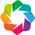

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .RGB.I   :RGB   [longitude,latitude]   (R,G,B,A)

In [ ]:
import holoviews as hv
from holoviews.element.tiles import EsriImagery
from holoviews.operation.datashader import datashade
from colorcet import fire
from datashader.utils import lnglat_to_meters
hv.extension('bokeh')

df.loc[:, 'longitude'], df.loc[:, 'latitude'] = lnglat_to_meters(df.lon, df.lat)

map_tiles  = EsriImagery().opts(width=1200, height=550, xaxis=None, yaxis=None, show_grid=False)
points     = hv.Points(df, ['longitude', 'latitude'])
coords = datashade(points, x_sampling=0.1, y_sampling=0.1, cmap=fire, width=1200, height=550)

map_tiles * coords